<a href="https://colab.research.google.com/github/pitbuk101/colab-files/blob/main/infrence.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Florence-2-large sample usage

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
%ls

drive/  sample_data/


In [5]:
%cd /content/drive/MyDrive/Colab Notebooks

/content/drive/MyDrive/Colab Notebooks


In [23]:
from transformers import AutoProcessor, AutoModelForCausalLM
from PIL import Image, ImageDraw
import requests
import copy
%matplotlib inline

In [7]:
!pip install flash_attn einops timm

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.6/2.6 MB 35.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.2/43.2 kB 7.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 75.4 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cuspa

In [8]:
import torch
if torch.cuda.is_available():
    print("GPU is available!")
    print("Device name:", torch.cuda.get_device_name(0))
else:
    print("GPU is not available. Please check your Colab settings.")

GPU is available!
Device name: Tesla T4


In [9]:
model_id = 'microsoft/Florence-2-large'
model = AutoModelForCausalLM.from_pretrained(model_id, trust_remote_code=True).eval().cuda()
processor = AutoProcessor.from_pretrained(model_id, trust_remote_code=True)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/2.44k [00:00<?, ?B/s]

configuration_florence2.py:   0%|          | 0.00/15.1k [00:00<?, ?B/s]

A new version of the following files was downloaded from https://huggingface.co/microsoft/Florence-2-large:
- configuration_florence2.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.


modeling_florence2.py:   0%|          | 0.00/127k [00:00<?, ?B/s]

A new version of the following files was downloaded from https://huggingface.co/microsoft/Florence-2-large:
- modeling_florence2.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.


pytorch_model.bin:   0%|          | 0.00/1.54G [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/51.0 [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

processing_florence2.py:   0%|          | 0.00/46.4k [00:00<?, ?B/s]

A new version of the following files was downloaded from https://huggingface.co/microsoft/Florence-2-large:
- processing_florence2.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.


tokenizer_config.json:   0%|          | 0.00/34.0 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.10M [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

## define the prediction function

In [10]:
def run_example(task_prompt, text_input=None):
    if text_input is None:
        prompt = task_prompt
    else:
        prompt = task_prompt + text_input
    inputs = processor(text=prompt, images=image, return_tensors="pt")
    generated_ids = model.generate(
      input_ids=inputs["input_ids"].cuda(),
      pixel_values=inputs["pixel_values"].cuda(),
      max_new_tokens=1024,
      early_stopping=False,
      do_sample=False,
      num_beams=3,
    )
    generated_text = processor.batch_decode(generated_ids, skip_special_tokens=False)[0]
    parsed_answer = processor.post_process_generation(
        generated_text,
        task=task_prompt,
        image_size=(image.width, image.height)
    )

    return parsed_answer

## init image

In [9]:
url = "https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/transformers/tasks/car.jpg?download=true"
image = Image.open(requests.get(url, stream=True).raw)

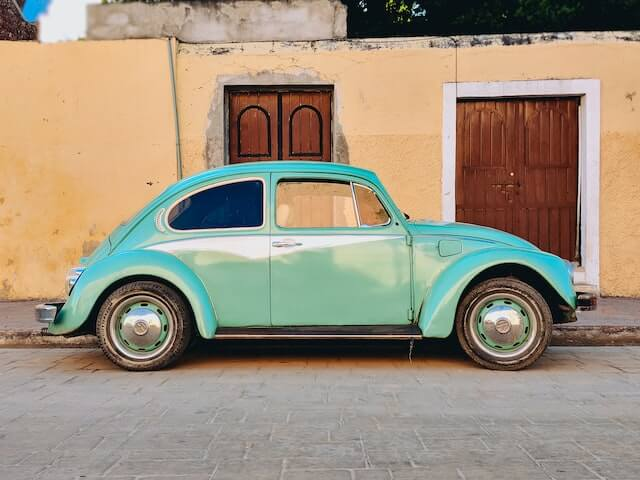

In [10]:
image

## Run pre-defined tasks without additional inputs

### Caption

In [11]:
task_prompt = '<CAPTION>'
run_example(task_prompt)

{'<CAPTION>': '\nA green car parked in front of a yellow building.\n'}

In [12]:
task_prompt = '<DETAILED_CAPTION>'
run_example(task_prompt)

{'<DETAILED_CAPTION>': '\nThe image shows a green Volkswagen Beetle parked in front of a yellow building with two brown doors. The sky is a mix of blue and white, and there are a few green trees in the background.\n'}

In [13]:
task_prompt = '<MORE_DETAILED_CAPTION>'
run_example(task_prompt)

{'<MORE_DETAILED_CAPTION>': '\nThe image shows a vintage Volkswagen Beetle car parked on a cobblestone street in front of a yellow building with two wooden doors. The car is painted in a bright turquoise color and has a white stripe running along the side. It has two doors on either side of the car, one on top of the other, and a small window on the front. The building appears to be old and dilapidated, with peeling paint and crumbling walls. The sky is blue and there are trees in the background.\n'}

### Object detection

OD results format:
{'\<OD>':
    {
    'bboxes': [[x1, y1, x2, y2], ...],
    'labels': ['label1', 'label2', ...]
    }
}

In [14]:
task_prompt = '<OD>'
results = run_example(task_prompt)
print(results)

{'<OD>': {'bboxes': [[34.23999786376953, 160.0800018310547, 597.4400024414062, 371.7599792480469], [456.0, 97.68000030517578, 580.1599731445312, 261.8399963378906], [450.8800048828125, 276.7200012207031, 554.5599975585938, 370.79998779296875], [95.68000030517578, 280.55999755859375, 198.72000122070312, 371.2799987792969]], 'labels': ['car', 'door', 'wheel', 'wheel']}}


In [15]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
def plot_bbox(image, data):
   # Create a figure and axes
    fig, ax = plt.subplots()

    # Display the image
    ax.imshow(image)

    # Plot each bounding box
    for bbox, label in zip(data['bboxes'], data['labels']):
        # Unpack the bounding box coordinates
        x1, y1, x2, y2 = bbox
        # Create a Rectangle patch
        rect = patches.Rectangle((x1, y1), x2-x1, y2-y1, linewidth=1, edgecolor='r', facecolor='none')
        # Add the rectangle to the Axes
        ax.add_patch(rect)
        # Annotate the label
        plt.text(x1, y1, label, color='white', fontsize=8, bbox=dict(facecolor='red', alpha=0.5))

    # Remove the axis ticks and labels
    ax.axis('off')

    # Show the plot
    plt.show()

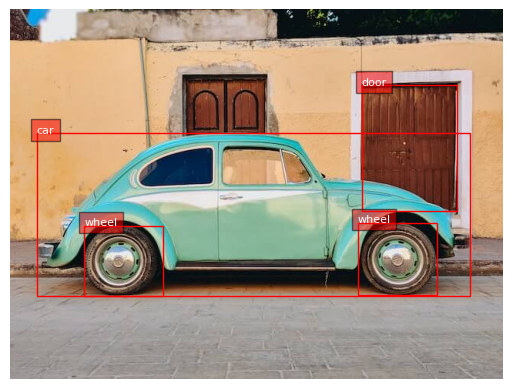

In [16]:
plot_bbox(image, results['<OD>'])

### Dense region caption

Dense region caption results format:
{'\<DENSE_REGION_CAPTION>': {'bboxes': [[x1, y1, x2, y2], ...], 'labels': ['label1', 'label2', ...]}}

In [17]:
task_prompt = '<DENSE_REGION_CAPTION>'
results = run_example(task_prompt)
print(results)

{'<DENSE_REGION_CAPTION>': {'bboxes': [[33.599998474121094, 160.0800018310547, 596.7999877929688, 371.7599792480469], [450.8800048828125, 276.7200012207031, 553.2799682617188, 370.79998779296875], [95.04000091552734, 280.55999755859375, 197.44000244140625, 371.2799987792969]], 'labels': ['turquoise Volkswagen Beetle', 'wheel', 'wheel']}}


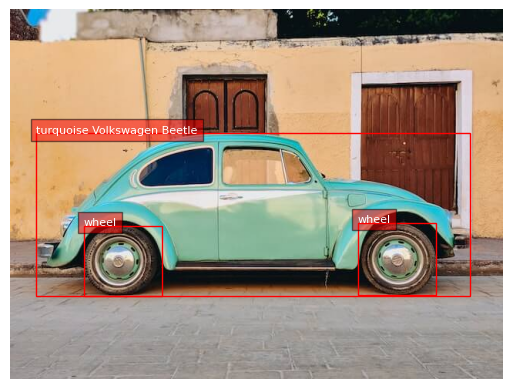

In [18]:
plot_bbox(image, results['<DENSE_REGION_CAPTION>'])

### Region proposal

Region proposal results format:
{'<REGION_PROPOSAL>' : {'bboxes': [[x1, y1, x2, y2], ...], 'labels': ['', '', ...]}}

In [19]:
task_prompt = '<REGION_PROPOSAL>'
results = run_example(task_prompt)
print(results)

{'<REGION_PROPOSAL>': {'bboxes': [[33.599998474121094, 160.0800018310547, 596.7999877929688, 371.7599792480469], [455.3599853515625, 97.68000030517578, 579.5199584960938, 261.8399963378906], [450.8800048828125, 276.7200012207031, 553.2799682617188, 370.79998779296875], [95.04000091552734, 280.55999755859375, 198.0800018310547, 371.2799987792969], [226.87998962402344, 88.55999755859375, 332.47998046875, 164.39999389648438], [65.5999984741211, 266.6399841308594, 86.72000122070312, 295.91998291015625], [271.67999267578125, 241.67999267578125, 302.3999938964844, 246.95999145507812], [408.0, 308.3999938964844, 413.7599792480469, 320.8800048828125]], 'labels': ['', '', '', '', '', '', '', '']}}


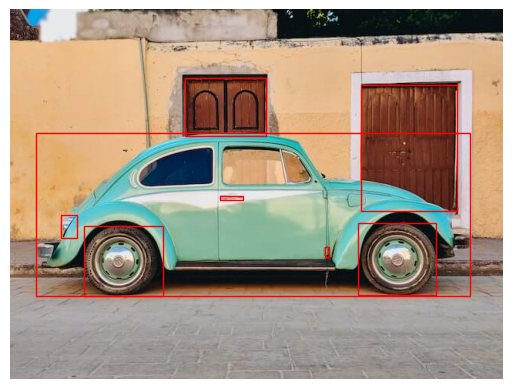

In [20]:
plot_bbox(image, results['<REGION_PROPOSAL>'])

## Run pre-defined tasks that requires additional inputs

### Phrase Grounding
Phrase grounding results format:
{'\<CAPTION_TO_PHRASE_GROUNDING>': {'bboxes': [[x1, y1, x2, y2], ...], 'labels': ['', '', ...]}}

In [21]:
task_prompt = '<CAPTION_TO_PHRASE_GROUNDING>'
results = run_example(task_prompt, text_input="A green car parked in front of a yellow building.")
print(results)

{'<CAPTION_TO_PHRASE_GROUNDING>': {'bboxes': [[34.880001068115234, 158.63999938964844, 583.3599853515625, 374.6399841308594], [0.3199999928474426, 4.079999923706055, 639.0399780273438, 305.03997802734375]], 'labels': ['A green car', 'a yellow building']}}


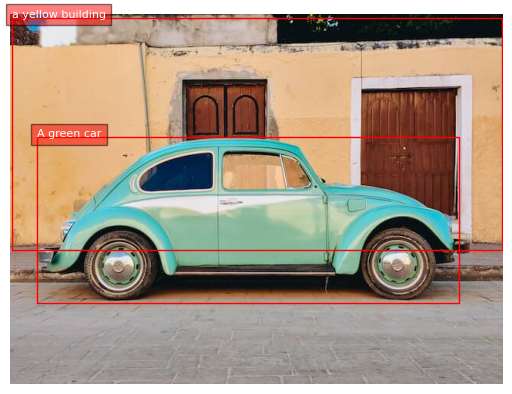

In [ ]:
plot_bbox(image, results['<CAPTION_TO_PHRASE_GROUNDING>'])

### Referring expression segmentation

Referring expression segmentation results format:
{'\<REFERRING_EXPRESSION_SEGMENTATION>': {'Polygons': [[[polygon]], ...], 'labels': ['', '', ...]}}, one object is represented by a list of polygons. each polygon is [x1, y1, x2, y2, ..., xn, yn]

In [22]:
task_prompt = '<REFERRING_EXPRESSION_SEGMENTATION>'
results = run_example(task_prompt, text_input="a green car")
print(results)

{'<REFERRING_EXPRESSION_SEGMENTATION>': {'polygons': [[[178.87998962402344, 181.67999267578125, 180.8000030517578, 180.72000122070312, 182.72000122070312, 180.72000122070312, 187.83999633789062, 177.83999633789062, 189.75999450683594, 177.83999633789062, 192.95999145507812, 175.9199981689453, 194.87998962402344, 175.9199981689453, 198.0800018310547, 174.0, 200.63999938964844, 173.0399932861328, 203.83999633789062, 172.0800018310547, 207.0399932861328, 170.63999938964844, 209.59999084472656, 169.67999267578125, 214.0800018310547, 168.72000122070312, 217.9199981689453, 167.75999450683594, 221.75999450683594, 166.8000030517578, 226.239990234375, 165.83999633789062, 230.72000122070312, 164.87998962402344, 237.1199951171875, 163.9199981689453, 244.1599884033203, 162.95999145507812, 253.1199951171875, 162.0, 265.2799987792969, 161.0399932861328, 311.3599853515625, 161.0399932861328, 329.2799987792969, 162.0, 338.239990234375, 162.95999145507812, 345.2799987792969, 163.9199981689453, 350.3999

In [23]:
from PIL import Image, ImageDraw, ImageFont
import random
import numpy as np
colormap = ['blue','orange','green','purple','brown','pink','gray','olive','cyan','red',
            'lime','indigo','violet','aqua','magenta','coral','gold','tan','skyblue']
def draw_polygons(image, prediction, fill_mask=False):
    """
    Draws segmentation masks with polygons on an image.

    Parameters:
    - image_path: Path to the image file.
    - prediction: Dictionary containing 'polygons' and 'labels' keys.
                  'polygons' is a list of lists, each containing vertices of a polygon.
                  'labels' is a list of labels corresponding to each polygon.
    - fill_mask: Boolean indicating whether to fill the polygons with color.
    """
    # Load the image

    draw = ImageDraw.Draw(image)


    # Set up scale factor if needed (use 1 if not scaling)
    scale = 1

    # Iterate over polygons and labels
    for polygons, label in zip(prediction['polygons'], prediction['labels']):
        color = random.choice(colormap)
        fill_color = random.choice(colormap) if fill_mask else None

        for _polygon in polygons:
            _polygon = np.array(_polygon).reshape(-1, 2)
            if len(_polygon) < 3:
                print('Invalid polygon:', _polygon)
                continue

            _polygon = (_polygon * scale).reshape(-1).tolist()

            # Draw the polygon
            if fill_mask:
                draw.polygon(_polygon, outline=color, fill=fill_color)
            else:
                draw.polygon(_polygon, outline=color)

            # Draw the label text
            draw.text((_polygon[0] + 8, _polygon[1] + 2), label, fill=color)

    # Save or display the image
    #image.show()  # Display the image
    display(image)

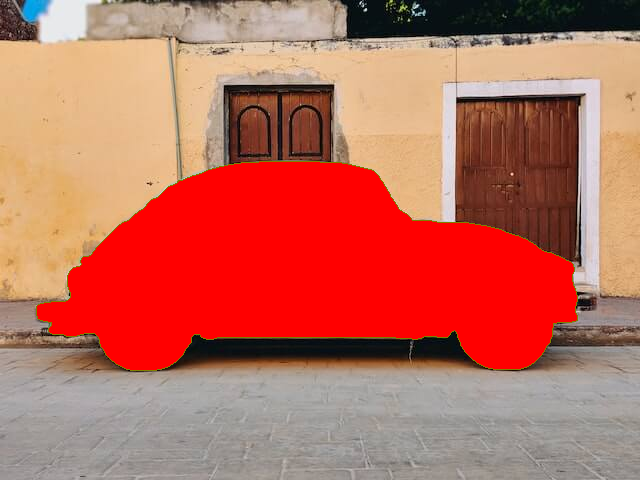

In [24]:
output_image = copy.deepcopy(image)
draw_polygons(output_image, results['<REFERRING_EXPRESSION_SEGMENTATION>'], fill_mask=True)

### region to segmentation


with additional region as inputs, format is '\<loc_x1>\<loc_y1>\<loc_x2>\<loc_y2>', [x1, y1, x2, y2] is the quantized corrdinates in [0, 999].

In [25]:
task_prompt = '<REGION_TO_SEGMENTATION>'
results = run_example(task_prompt, text_input="<loc_702><loc_575><loc_866><loc_772>")
print(results)

{'<REGION_TO_SEGMENTATION>': {'polygons': [[[470.0799865722656, 288.239990234375, 473.91998291015625, 285.3599853515625, 477.1199951171875, 283.44000244140625, 479.03997802734375, 282.47998046875, 480.9599914550781, 282.47998046875, 484.1600036621094, 280.55999755859375, 486.7200012207031, 279.6000061035156, 489.91998291015625, 278.6399841308594, 495.03997802734375, 277.67999267578125, 512.3200073242188, 277.67999267578125, 514.8800048828125, 278.6399841308594, 518.0800170898438, 279.6000061035156, 521.2799682617188, 281.5199890136719, 523.2000122070312, 281.5199890136719, 525.1199951171875, 283.44000244140625, 528.3200073242188, 284.3999938964844, 530.8800048828125, 286.32000732421875, 534.0800170898438, 288.239990234375, 543.0399780273438, 297.3599853515625, 544.9599609375, 300.239990234375, 546.8800048828125, 303.1199951171875, 550.0800170898438, 309.3599853515625, 551.3599853515625, 312.239990234375, 552.0, 315.1199951171875, 553.2799682617188, 319.44000244140625, 553.2799682617188

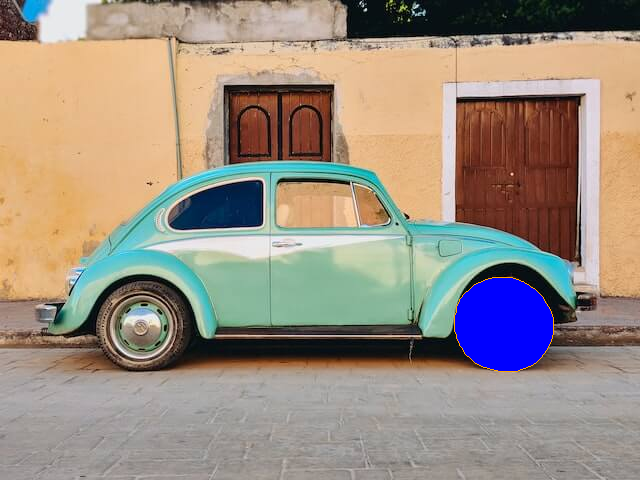

In [26]:
output_image = copy.deepcopy(image)
draw_polygons(output_image, results['<REGION_TO_SEGMENTATION>'], fill_mask=True)

### Open vocabulary detection

open vocabulary detection can detect both objects and ocr texts.

results format:

{ '\<OPEN_VOCABULARY_DETECTION>': {'bboxes': [[x1, y1, x2, y2], [x1, y1, x2, y2], ...]], 'bboxes_labels': ['label_1', 'label_2', ..],
'polygons': [[[x1, y1, x2, y2, ..., xn, yn], [x1, y1, ..., xn, yn]], ...], 'polygons_labels': ['label_1', 'label_2', ...]
}}

In [ ]:
task_prompt = '<OPEN_VOCABULARY_DETECTION>'
results = run_example(task_prompt, text_input="a green car")
print(results)

{'<OPEN_VOCABULARY_DETECTION>': {'bboxes': [[34.23999786376953, 158.63999938964844, 582.0800170898438, 374.1600036621094]], 'bboxes_labels': ['a green car'], 'polygons': [], 'polygons_labels': []}}


In [ ]:
def convert_to_od_format(data):
    """
    Converts a dictionary with 'bboxes' and 'bboxes_labels' into a dictionary with separate 'bboxes' and 'labels' keys.

    Parameters:
    - data: The input dictionary with 'bboxes', 'bboxes_labels', 'polygons', and 'polygons_labels' keys.

    Returns:
    - A dictionary with 'bboxes' and 'labels' keys formatted for object detection results.
    """
    # Extract bounding boxes and labels
    bboxes = data.get('bboxes', [])
    labels = data.get('bboxes_labels', [])

    # Construct the output format
    od_results = {
        'bboxes': bboxes,
        'labels': labels
    }

    return od_results

In [ ]:
bbox_results  = convert_to_od_format(results['<OPEN_VOCABULARY_DETECTION>'])

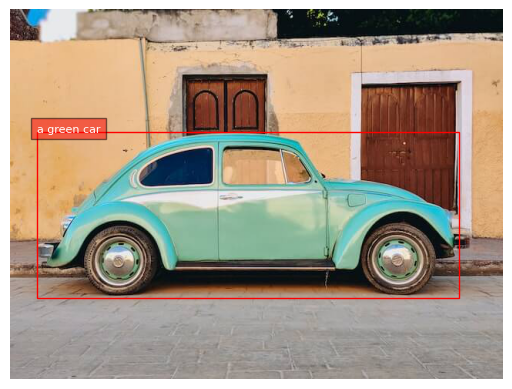

In [ ]:
plot_bbox(image, bbox_results)

### region to texts

In [ ]:
task_prompt = '<REGION_TO_CATEGORY>'
results = run_example(task_prompt, text_input="<loc_52><loc_332><loc_932><loc_774>")
print(results)

{'<REGION_TO_CATEGORY>': 'car<loc_52><loc_332><loc_932><loc_774>'}


In [ ]:
task_prompt = '<REGION_TO_DESCRIPTION>'
results = run_example(task_prompt, text_input="<loc_52><loc_332><loc_932><loc_774>")
print(results)

{'<REGION_TO_DESCRIPTION>': 'turquoise Volkswagen Beetle<loc_52><loc_332><loc_932><loc_774>'}


## ocr related tasks

In [11]:
# url = "http://ecx.images-amazon.com/images/I/51UUzBDAMsL.jpg?download=true"
image = Image.open("/content/drive/MyDrive/Colab Notebooks/page_5108984_2.png")

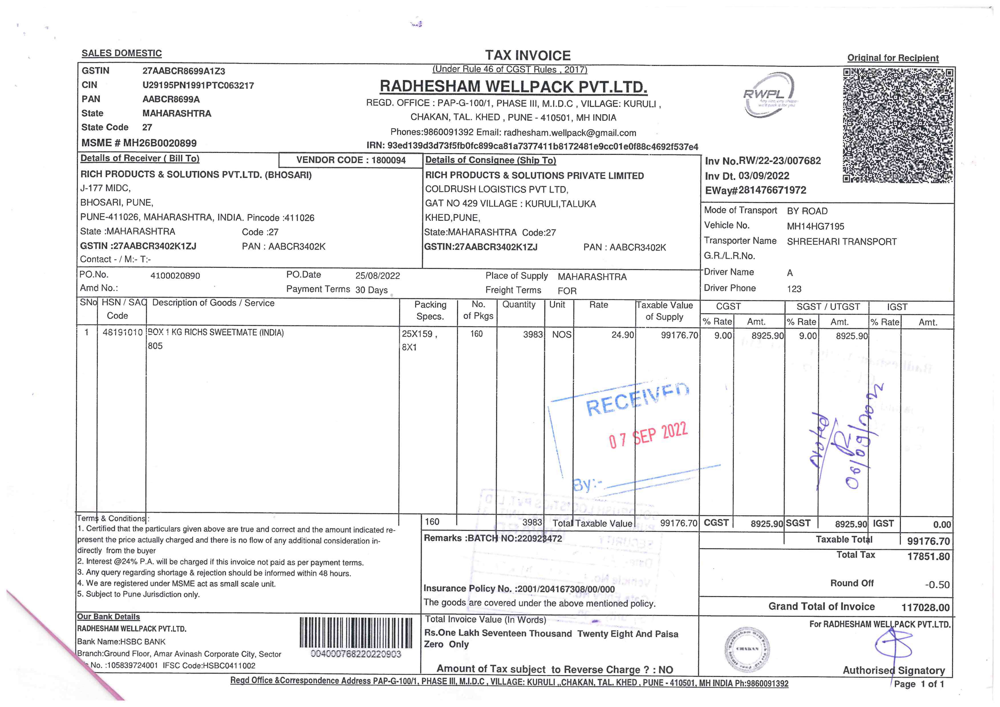

In [34]:
image

In [19]:
task_prompt = '<OCR>'
run_example(task_prompt)

{'<OCR>': '\nTAX INVOICESALES DOMESTIC(Under Rule 46 of GST Rules, 2017)Original for RecipientGSTN27ABRC89A123RADHESHAM WELLPACK PVT.LTD.CINU2SPN19P1PTC063C217RWRPLStateMAHRASHTRAREGD. OFFICE : PAPG-1001, PUNE, PHASE 3, M.D., VILLAGE, KURPUL,State Code27CHAKAN, TAL KED, Pune, 44101, MINDIAState CodeMMSME : MHR60080090009Phone: +86-98003738/Email: rahatasharma@gmail.comDetails of Receiver (Bill To)VENDOR CODE : 180094Details of Consistency (Ship To)RICH PRODUCTS & SOLUTIONS PRIVATE LIMITEDInvo. RW22-233007682RICH PRODUCES PVT LTD. (BHOSAR)Details of CONSISTENCY PVT Ltd.Inv. Dr. 30/03/2022BHOSHAN PUNE.GATO TO K2 VILAGE. KURULALITAKMode of Transport BY ROADPUNE-1106, MAHRASTHRA, INDIA, Pincode 410105KHED PUNEVehicle No.BY-1467671972State MAHRASHRACode 27State: MARHARASTA Code27PAN: 27ABRC9024KZPAN : ABRC9034KZGSTIN: 27ABC9024KTZJTransport NameSHREHARI TRANSPORTContact : M.T..G.L.No.P.O.PO.Date: 25/08/22Pace of SupplyMAHRASHRITRADriver NameAddress: 400008090Payment Terms 30 DaysPacking:Fre

In [35]:
task_prompt = '<OCR_WITH_REGION>'
results = run_example(task_prompt)
print(results)
# ocr results format
# {'OCR_WITH_REGION': {'quad_boxes': [[x1, y1, x2, y2, x3, y3, x4, y4], ...], 'labels': ['text1', ...]}}

{'<OCR_WITH_REGION>': {'quad_boxes': [[2212.33251953125, 452.6729736328125, 3778.79248046875, 456.8069763183594, 3778.79248046875, 547.7550048828125, 2212.33251953125, 543.6209716796875]], 'labels': ['RADHESHAM WELLPACK PVT.LTD.']}}


In [26]:
import random

In [27]:
# def draw_ocr_bboxes(image, prediction):
#     scale = 1
#     draw = ImageDraw.Draw(image)
#     bboxes, labels = prediction['quad_boxes'], prediction['labels']
#     for box, label in zip(bboxes, labels):
#         color = random.choice(colormap)
#         new_box = (np.array(box) * scale).tolist()
#         draw.polygon(new_box, width=3, outline=color)
#         draw.text((new_box[0]+8, new_box[1]+2),
#                     "{}".format(label),
#                     align="right",

#                     fill=color)
#     display(image)


In [31]:
import random
from PIL import Image, ImageDraw
import numpy as np

def draw_ocr_bboxes(image, prediction):
    # Define colormap here
    colormap = [(255, 0, 0), (0, 255, 0), (0, 0, 255)] # Example colormap

    scale = 1
    draw = ImageDraw.Draw(image)
    bboxes, labels = prediction['quad_boxes'], prediction['labels']
    for box, label in zip(bboxes, labels):
        color = random.choice(colormap)
        new_box = (np.array(box) * scale).tolist()
        draw.polygon(new_box, width=3, outline=color)
        draw.text((new_box[0]+8, new_box[1]+2),
                    "{}".format(label),
                    align="right",

                    fill=color)
    display(image)

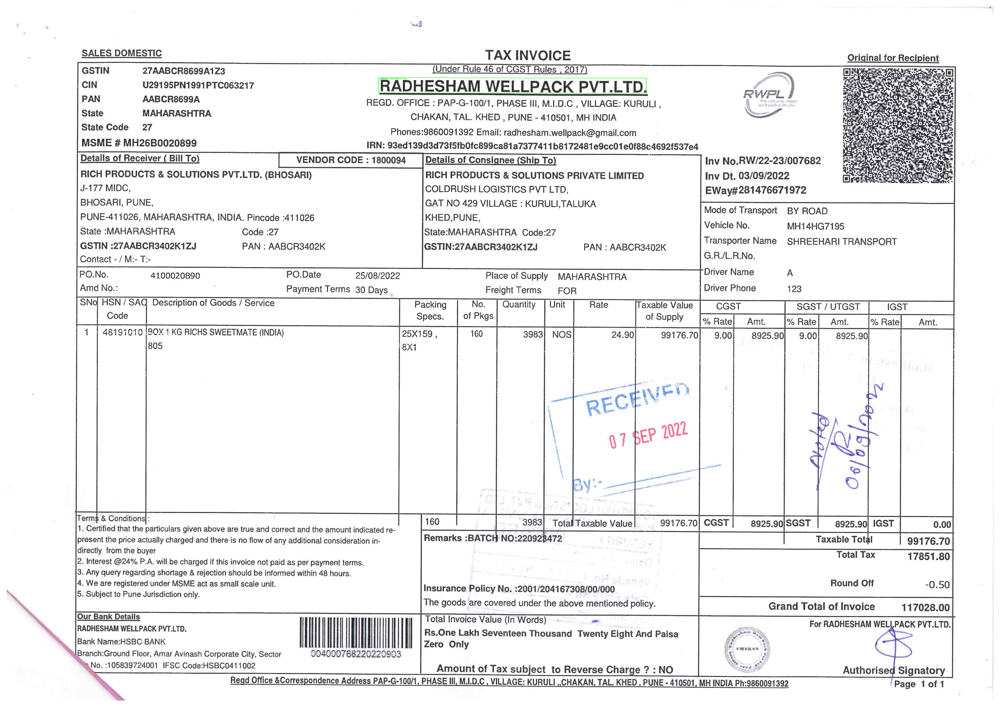

In [32]:
output_image = copy.deepcopy(image)
draw_ocr_bboxes(output_image, results['<OCR_WITH_REGION>'])

## Cascaded tasks

### Caption + Phrase Grounding

results format:

{
 '\<CAPTION': pure_text,
{'\<CAPTION_TO_PHRASE_GROUNDING>': {'bboxes': [[x1, y1, x2, y2], ...], 'labels': ['', '', ...]}}
}

In [ ]:
url = "https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/transformers/tasks/car.jpg?download=true"
image = Image.open(requests.get(url, stream=True).raw)

In [ ]:
task_prompt = '<CAPTION>'
results = run_example(task_prompt)
text_input = results[task_prompt]
task_prompt = '<CAPTION_TO_PHRASE_GROUNDING>'
results = run_example(task_prompt, text_input)
results['<CAPTION>'] = text_input

In [ ]:
results

{'<CAPTION_TO_PHRASE_GROUNDING>': {'bboxes': [[34.23999786376953,
    159.1199951171875,
    582.0800170898438,
    374.6399841308594],
   [1.5999999046325684,
    4.079999923706055,
    639.0399780273438,
    305.03997802734375]],
  'labels': ['A green car', 'a yellow building']},
 '<CAPTION>': 'A green car parked in front of a yellow building.'}

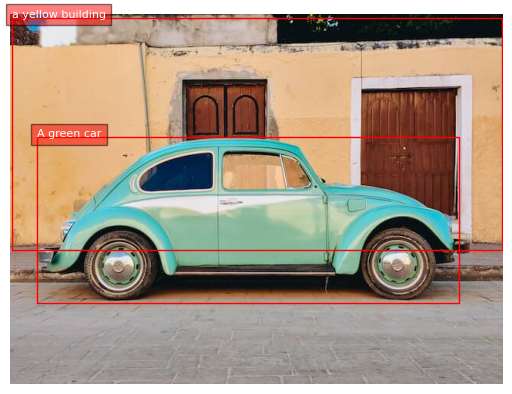

In [ ]:
plot_bbox(image, results['<CAPTION_TO_PHRASE_GROUNDING>'])

### Detailed Caption + Phrase Grounding

results format:

{
 '\<DETAILED_CAPTION': pure_text,
{'\<CAPTION_TO_PHRASE_GROUNDING>': {'bboxes': [[x1, y1, x2, y2], ...], 'labels': ['', '', ...]}}
}

In [ ]:
task_prompt = '<DETAILED_CAPTION>'
results = run_example(task_prompt)
text_input = results[task_prompt]
task_prompt = '<CAPTION_TO_PHRASE_GROUNDING>'
results = run_example(task_prompt, text_input)
results['<DETAILED_CAPTION>'] = text_input

In [ ]:
results

{'<CAPTION_TO_PHRASE_GROUNDING>': {'bboxes': [[33.599998474121094,
    158.63999938964844,
    582.719970703125,
    375.1199951171875],
   [1.5999999046325684, 5.039999961853027, 639.0399780273438, 306.0],
   [452.79998779296875,
    94.31999969482422,
    582.0800170898438,
    265.67999267578125],
   [222.39999389648438,
    84.23999786376953,
    335.03997802734375,
    167.27999877929688],
   [2.240000009536743,
    1.1999999284744263,
    639.0399780273438,
    43.91999816894531],
   [343.3599853515625,
    1.1999999284744263,
    639.0399780273438,
    40.55999755859375],
   [2.240000009536743,
    1.1999999284744263,
    638.3999633789062,
    43.91999816894531],
   [18.239999771118164,
    1.1999999284744263,
    104.63999938964844,
    45.36000061035156]],
  'labels': ['a blue Volkswagen Beetle',
   'a yellow building',
   'brown doors',
   'brown doors',
   'trees',
   'trees',
   'a clear blue sky',
   'a clear blue sky']},
 '<DETAILED_CAPTION>': 'The image shows a blue Vol

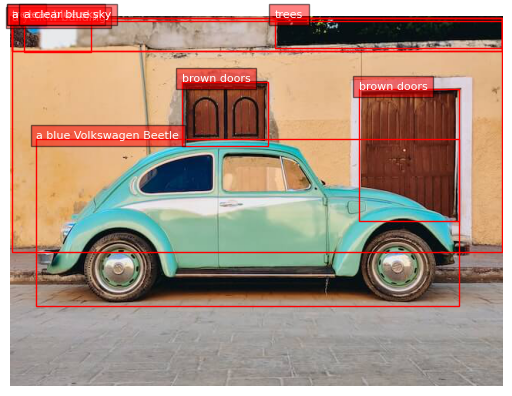

In [ ]:
plot_bbox(image, results['<CAPTION_TO_PHRASE_GROUNDING>'])

### More Detailed Caption + Phrase Grounding

results format:

{
 '\<MORE_DETAILED_CAPTION': pure_text,
{'\<CAPTION_TO_PHRASE_GROUNDING>': {'bboxes': [[x1, y1, x2, y2], ...], 'labels': ['', '', ...]}}
}

In [ ]:
task_prompt = '<MORE_DETAILED_CAPTION>'
results = run_example(task_prompt)
text_input = results[task_prompt]
task_prompt = '<CAPTION_TO_PHRASE_GROUNDING>'
results = run_example(task_prompt, text_input)
results['<MORE_DETAILED_CAPTION>'] = text_input

In [ ]:
results

{'<CAPTION_TO_PHRASE_GROUNDING>': {'bboxes': [[35.52000045776367,
    157.67999267578125,
    581.4400024414062,
    372.7200012207031],
   [1.5999999046325684,
    340.0799865722656,
    639.0399780273438,
    479.2799987792969],
   [454.0799865722656,
    93.83999633789062,
    580.7999877929688,
    263.2799987792969],
   [223.67999267578125,
    84.23999786376953,
    333.7599792480469,
    163.9199981689453],
   [36.79999923706055,
    157.67999267578125,
    580.1599731445312,
    372.239990234375],
   [454.0799865722656,
    93.83999633789062,
    581.4400024414062,
    263.2799987792969],
   [223.67999267578125,
    84.72000122070312,
    333.7599792480469,
    163.9199981689453],
   [164.16000366210938,
    177.36000061035156,
    265.2799987792969,
    232.0800018310547],
   [2.879999876022339,
    4.559999942779541,
    639.0399780273438,
    301.1999816894531],
   [19.520000457763672, 1.1999999284744263, 639.0399780273438, 42.0],
   [20.15999984741211,
    0.719999969005584

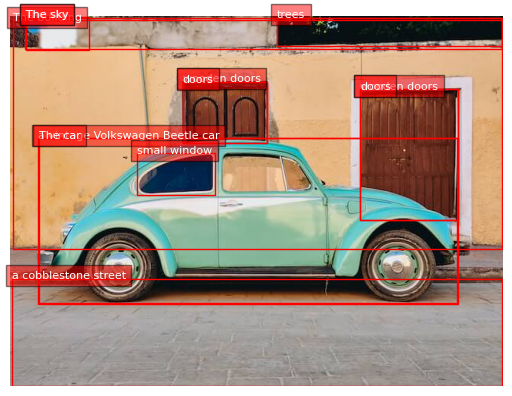

In [ ]:
plot_bbox(image, results['<CAPTION_TO_PHRASE_GROUNDING>'])

In [1]:
!pip install 'lmdeploy>=0.4.0'
!pip install git+https://github.com/haotian-liu/LLaVA.git --no-deps


  Cloning https://github.com/haotian-liu/LLaVA.git to /tmp/pip-req-build-c0l1a6ud
  Running command git clone --filter=blob:none --quiet https://github.com/haotian-liu/LLaVA.git /tmp/pip-req-build-c0l1a6ud
  Resolved https://github.com/haotian-liu/LLaVA.git to commit c121f0432da27facab705978f83c4ada465e46fd
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for llava: filename=llava-1.2.2.post1-py3-none-any.whl size=103210 sha256=250774705590a6c0900fa29cb697233d5b05aaa6a10d87b5057bca86fef3f3eb
  Stored in directory: /tmp/pip-ephem-wheel-cache-350rnb0z/wheels/cb/30/cb/d7743286431879b4fcf542c946f9a4b96c1fa7ca87c3d007e5
Successfully built llava


In [7]:
!pip install git+https://github.com/haotian-liu/LLaVA.git


  Cloning https://github.com/haotian-liu/LLaVA.git to /tmp/pip-req-build-q8zfzj67
  Running command git clone --filter=blob:none --quiet https://github.com/haotian-liu/LLaVA.git /tmp/pip-req-build-q8zfzj67
  Resolved https://github.com/haotian-liu/LLaVA.git to commit c121f0432da27facab705978f83c4ada465e46fd
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 670.2/670.2 MB 1.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.8/6.8 MB 99.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.4/8.4 MB 95.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.6 MB 72.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 244.2/244.2 kB 31.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 119.8/119.8 MB 6.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 47.2/47.2 kB 3.9 MB/s eta 

In [3]:
from lmdeploy import pipeline, ChatTemplateConfig
from lmdeploy.vl import load_image
pipe = pipeline('xtuner/llava-llama-3-8b-v1_1-hf',
                chat_template_config=ChatTemplateConfig(model_name='llama3'))

image = load_image('https://raw.githubusercontent.com/open-mmlab/mmdeploy/main/tests/data/tiger.jpeg')
response = pipe(('describe this image', image))
print(response)


Fetching 18 files:   0%|          | 0/18 [00:00<?, ?it/s]

The argument `trust_remote_code` is to be used with Auto classes. It has no effect here and is ignored.
You are using a model of type llava_llama to instantiate a model of type . This is not supported for all configurations of models and can yield errors.


ImportError: To use LlavaVLModel, please install llava by pip install git+https://github.com/haotian-liu/LLaVA.git --no-deps

In [1]:
!pip install git+https://github.com/haotian-liu/LLaVA.git

  Cloning https://github.com/haotian-liu/LLaVA.git to /tmp/pip-req-build-4bie62kl
  Running command git clone --filter=blob:none --quiet https://github.com/haotian-liu/LLaVA.git /tmp/pip-req-build-4bie62kl
  Resolved https://github.com/haotian-liu/LLaVA.git to commit c121f0432da27facab705978f83c4ada465e46fd
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 670.2/670.2 MB 1.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.8/6.8 MB 60.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.4/8.4 MB 68.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.6 MB 53.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 244.2/244.2 kB 24.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 251.6/251.6 kB 28.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 119.8/119.8 MB 8.5 MB/s e

In [22]:
import argparse
from io import BytesIO

import requests
import torch
from llava.constants import DEFAULT_IMAGE_TOKEN, IMAGE_TOKEN_INDEX
from llava.conversation import Conversation, SeparatorStyle
from llava.mm_utils import process_images, tokenizer_image_token
from llava.model import LlavaLlamaForCausalLM
from PIL import Image
from transformers import (AutoTokenizer, BitsAndBytesConfig, StoppingCriteria,
                          StoppingCriteriaList, TextStreamer)


def load_image(image_file):
    if image_file.startswith('http://') or image_file.startswith('https://'):
        response = requests.get(image_file)
        image = Image.open(BytesIO(response.content)).convert('RGB')
    else:
        image = Image.open(image_file).convert('RGB')
    return image


class StopWordStoppingCriteria(StoppingCriteria):
    """StopWord stopping criteria."""

    def __init__(self, tokenizer, stop_word):
        self.tokenizer = tokenizer
        self.stop_word = stop_word
        self.length = len(self.stop_word)

    def __call__(self, input_ids, *args, **kwargs) -> bool:
        cur_text = self.tokenizer.decode(input_ids[0])
        cur_text = cur_text.replace('\r', '').replace('\n', '')
        return cur_text[-self.length:] == self.stop_word


def get_stop_criteria(tokenizer, stop_words=[]):
    stop_criteria = StoppingCriteriaList()
    for word in stop_words:
        stop_criteria.append(StopWordStoppingCriteria(tokenizer, word))
    return stop_criteria


def main(args):
    kwargs = {'device_map': args.device}
    if args.load_8bit:
        kwargs['load_in_8bit'] = True
    elif args.load_4bit:
        kwargs['load_in_4bit'] = True
        kwargs['quantization_config'] = BitsAndBytesConfig(
            load_in_4bit=True,
            bnb_4bit_compute_dtype=torch.float16,
            bnb_4bit_use_double_quant=True,
            bnb_4bit_quant_type='nf4')
    else:
        kwargs['torch_dtype'] = torch.float16

    tokenizer = AutoTokenizer.from_pretrained(args.model_path)
    model = LlavaLlamaForCausalLM.from_pretrained(
        args.model_path, low_cpu_mem_usage=True, **kwargs)
    vision_tower = model.get_vision_tower()
    if not vision_tower.is_loaded:
        vision_tower.load_model(device_map=args.device)
    image_processor = vision_tower.image_processor

    conv = Conversation(
        system='<|system|>\nAnswer the questions.',
        roles=('<|user|>\n', '<|assistant|>\n'),
        messages=[],
        offset=0,
        sep_style=SeparatorStyle.MPT,
        sep='<|end|>',
    )
    roles = conv.roles

    image = load_image(args.image_file)
    image_size = image.size
    image_tensor = process_images([image], image_processor, model.config)

    if type(image_tensor) is list:
        image_tensor = [
            image.to(model.device, dtype=torch.float16)
            for image in image_tensor
        ]
    else:
        image_tensor = image_tensor.to(model.device, dtype=torch.float16)

    while True:
        try:
            inp = input(f'{roles[0]}: ')
        except EOFError:
            inp = ''
        if not inp:
            print('exit...')
            break

        print(f'{roles[1]}: ', end='')

        if image is not None:
            inp = DEFAULT_IMAGE_TOKEN + '\n' + inp
            image = None

        conv.append_message(conv.roles[0], inp)
        conv.append_message(conv.roles[1], None)
        prompt = conv.get_prompt()

        input_ids = tokenizer_image_token(
            prompt, tokenizer, IMAGE_TOKEN_INDEX,
            return_tensors='pt').unsqueeze(0).to(model.device)
        stop_criteria = get_stop_criteria(
            tokenizer=tokenizer, stop_words=[conv.sep])

        streamer = TextStreamer(
            tokenizer, skip_prompt=True, skip_special_tokens=True)

        with torch.inference_mode():
            output_ids = model.generate(
                input_ids,
                images=image_tensor,
                image_sizes=[image_size],
                do_sample=True if args.temperature > 0 else False,
                temperature=args.temperature,
                max_new_tokens=args.max_new_tokens,
                streamer=streamer,
                stopping_criteria=stop_criteria,
                use_cache=True)

        outputs = tokenizer.decode(output_ids[0]).strip()
        conv.messages[-1][-1] = outputs

        if args.debug:
            print('\n', {'prompt': prompt, 'outputs': outputs}, '\n')


if __name__ == '__main__':
    parser = argparse.ArgumentParser()
    parser.add_argument(
        '--model-path', type=str, default='xtuner/llava-llama-3-8b-v1_1-hf')
    parser.add_argument('--image-file', type=str, default = './content/page_5108984_2.png', required =False)
    parser.add_argument('--device', type=str, default='auto')
    parser.add_argument('--temperature', type=float, default=0.2)
    parser.add_argument('--max-new-tokens', type=int, default=512)
    parser.add_argument('--load-8bit', action='store_true')
    parser.add_argument('--load-4bit', action='store_true')
    parser.add_argument('--debug', action='store_true')
    # args.image-file = './content/page_5108984_2.png'
    args = parser.parse_args()

    main(args)


usage: colab_kernel_launcher.py [-h] [--model-path MODEL_PATH] [--image-file IMAGE_FILE]
                                [--device DEVICE] [--temperature TEMPERATURE]
                                [--max-new-tokens MAX_NEW_TOKENS] [--load-8bit] [--load-4bit]
                                [--debug]
colab_kernel_launcher.py: error: unrecognized arguments: -f /root/.local/share/jupyter/runtime/kernel-40ccb3d6-cda6-45dd-8af1-e8185fd76495.json


SystemExit: 2

/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py:3561: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)


In [13]:
import argparse
from io import BytesIO

import requests
import torch
from llava.constants import DEFAULT_IMAGE_TOKEN, IMAGE_TOKEN_INDEX
from llava.conversation import Conversation, SeparatorStyle
from llava.mm_utils import process_images, tokenizer_image_token
from llava.model import LlavaLlamaForCausalLM
from PIL import Image
from transformers import (AutoTokenizer, BitsAndBytesConfig, StoppingCriteria,
                          StoppingCriteriaList, TextStreamer)


def load_image(image_file):
    if image_file.startswith('http://') or image_file.startswith('https://'):
        response = requests.get(image_file)
        image = Image.open(BytesIO(response.content)).convert('RGB')
    else:
        image = Image.open(image_file).convert('RGB')
    return image


class StopWordStoppingCriteria(StoppingCriteria):
    """StopWord stopping criteria."""

    def __init__(self, tokenizer, stop_word):
        self.tokenizer = tokenizer
        self.stop_word = stop_word
        self.length = len(self.stop_word)

    def __call__(self, input_ids, *args, **kwargs) -> bool:
        cur_text = self.tokenizer.decode(input_ids[0])
        cur_text = cur_text.replace('\r', '').replace('\n', '')
        return cur_text[-self.length:] == self.stop_word


def get_stop_criteria(tokenizer, stop_words=[]):
    stop_criteria = StoppingCriteriaList()
    for word in stop_words:
        stop_criteria.append(StopWordStoppingCriteria(tokenizer, word))
    return stop_criteria


def main(args):
    kwargs = {'device_map': args.device}
    if args.load_8bit:
        kwargs['load_in_8bit'] = True
    elif args.load_4bit:
        kwargs['load_in_4bit'] = True
        kwargs['quantization_config'] = BitsAndBytesConfig(
            load_in_4bit=True,
            bnb_4bit_compute_dtype=torch.float16,
            bnb_4bit_use_double_quant=True,
            bnb_4bit_quant_type='nf4')
    else:
        kwargs['torch_dtype'] = torch.float16

    tokenizer = AutoTokenizer.from_pretrained(args.model_path)
    model = LlavaLlamaForCausalLM.from_pretrained(
        args.model_path, low_cpu_mem_usage=True, **kwargs)
    vision_tower = model.get_vision_tower()
    if not vision_tower.is_loaded:
        vision_tower.load_model(device_map=args.device)
    image_processor = vision_tower.image_processor

    conv = Conversation(
        system='<|system|>\nAnswer the questions.',
        roles=('<|user|>\n', '<|assistant|>\n'),
        messages=[],
        offset=0,
        sep_style=SeparatorStyle.MPT,
        sep='<|end|>',
    )
    roles = conv.roles

    args.image_file = './content/page_5108984_2.png'
    image = load_image(args.image_file)
    image_size = image.size
    image_tensor = process_images([image], image_processor, model.config)

    if type(image_tensor) is list:
        image_tensor = [
            image.to(model.device, dtype=torch.float16)
            for image in image_tensor
        ]
    else:
        image_tensor = image_tensor.to(model.device, dtype=torch.float16)

    while True:
        try:
            inp = input(f'{roles[0]}: ')
        except EOFError:
            inp = ''
        if not inp:
            print('exit...')
            break

        print(f'{roles[1]}: ', end='')

        if image is not None:
            inp = DEFAULT_IMAGE_TOKEN + '\n' + inp
            image = None  # Clear image after first use

        conv.append_message(conv.roles[0], inp)
        conv.append_message(conv.roles[1], None)
        prompt = conv.get_prompt()

        input_ids = tokenizer_image_token(
            prompt, tokenizer, IMAGE_TOKEN_INDEX,
            return_tensors='pt').unsqueeze(0).to(model.device)
        stop_criteria = get_stop_criteria(
            tokenizer=tokenizer, stop_words=[conv.sep])

        streamer = TextStreamer(
            tokenizer, skip_prompt=True, skip_special_tokens=True)

        with torch.inference_mode():
            output_ids = model.generate(
                input_ids,
                images=image_tensor,
                image_sizes=[image_size],
                do_sample=True if args.temperature > 0 else False,
                temperature=args.temperature,
                max_new_tokens=args.max_new_tokens,
                streamer=streamer,
                stopping_criteria=stop_criteria,
                use_cache=True)

        outputs = tokenizer.decode(output_ids[0]).strip()
        conv.messages[-1][-1] = outputs

        if args.debug:
            print('\n', {'prompt': prompt, 'outputs': outputs}, '\n')


if __name__ == '__main__':
    parser = argparse.ArgumentParser()
    parser.add_argument(
        '--model-path', type=str, default='xtuner/llava-llama-3-8b-v1_1-hf')
    parser.add_argument('--image-file', type=str, required=False)
    parser.add_argument('--device', type=str, default='auto')
    parser.add_argument('--temperature', type=float, default=0.2)
    parser.add_argument('--max-new-tokens', type=int, default=512)
    parser.add_argument('--load-8bit', action='store_true')
    parser.add_argument('--load-4bit', action='store_true')
    parser.add_argument('--debug', action='store_true')
    args = parser.parse_args()
    # Provide the image file path here, either directly or through user input

    main(args)

usage: colab_kernel_launcher.py [-h] [--model-path MODEL_PATH] [--image-file IMAGE_FILE]
                                [--device DEVICE] [--temperature TEMPERATURE]
                                [--max-new-tokens MAX_NEW_TOKENS] [--load-8bit] [--load-4bit]
                                [--debug]
colab_kernel_launcher.py: error: unrecognized arguments: -f /root/.local/share/jupyter/runtime/kernel-40ccb3d6-cda6-45dd-8af1-e8185fd76495.json


SystemExit: 2

In [23]:
%ls

page_5108984_2.png  sample_data/


In [25]:
!pip install accelerate


In [30]:
import argparse
from io import BytesIO

import requests
import torch
from llava.constants import DEFAULT_IMAGE_TOKEN, IMAGE_TOKEN_INDEX
from llava.conversation import Conversation, SeparatorStyle
from llava.mm_utils import process_images, tokenizer_image_token
from llava.model import LlavaLlamaForCausalLM
from PIL import Image
from transformers import (AutoTokenizer, BitsAndBytesConfig, StoppingCriteria,
                          StoppingCriteriaList, TextStreamer)
import accelerate


def load_image(image_file):
    if image_file.startswith('http://') or image_file.startswith('https://'):
        response = requests.get(image_file)
        image = Image.open(BytesIO(response.content)).convert('RGB')
    else:
        image = Image.open(image_file).convert('RGB')
    return image


class StopWordStoppingCriteria(StoppingCriteria):
    """StopWord stopping criteria."""

    def __init__(self, tokenizer, stop_word):
        self.tokenizer = tokenizer
        self.stop_word = stop_word
        self.length = len(self.stop_word)

    def __call__(self, input_ids, *args, **kwargs) -> bool:
        cur_text = self.tokenizer.decode(input_ids[0])
        cur_text = cur_text.replace('\r', '').replace('\n', '')
        return cur_text[-self.length:] == self.stop_word


def get_stop_criteria(tokenizer, stop_words=[]):
    stop_criteria = StoppingCriteriaList()
    for word in stop_words:
        stop_criteria.append(StopWordStoppingCriteria(tokenizer, word))
    return stop_criteria


def main(args):
    kwargs = {'torch_dtype': torch.float32}
    # kwargs = {'device_map': args.device}
    if args.load_8bit:
        kwargs['load_in_8bit'] = True
    elif args.load_4bit:
        kwargs['load_in_4bit'] = True
        kwargs['quantization_config'] = BitsAndBytesConfig(
            load_in_4bit=True,
            bnb_4bit_compute_dtype=torch.float32,
            bnb_4bit_use_double_quant=True,
            bnb_4bit_quant_type='nf4')
    else:
        kwargs['torch_dtype'] = torch.float32

    tokenizer = AutoTokenizer.from_pretrained(args.model_path)
    model = LlavaLlamaForCausalLM.from_pretrained(args.model_path, low_cpu_mem_usage=True, device_map='auto', **kwargs)
    vision_tower = model.get_vision_tower()
    if not vision_tower.is_loaded:
        vision_tower.load_model(device_map=args.device)
    image_processor = vision_tower.image_processor

    conv = Conversation(
        system='<|system|>\nAnswer the questions.',
        roles=('<|user|>\n', '<|assistant|>\n'),
        messages=[],
        offset=0,
        sep_style=SeparatorStyle.MPT,
        sep='<|end|>',
    )
    roles = conv.roles

    image = load_image(args.image_file)
    image_size = image.size
    image_tensor = process_images([image], image_processor, model.config)

    if type(image_tensor) is list:
        image_tensor = [
            image.to(model.device, dtype=torch.float32)
            for image in image_tensor
        ]
    else:
        image_tensor = image_tensor.to(model.device, dtype=torch.float32)

    while True:
        try:
            inp = input(f'{roles[0]}: ')
        except EOFError:
            inp = ''
        if not inp:
            print('exit...')
            break

        print(f'{roles[1]}: ', end='')

        if image is not None:
            inp = DEFAULT_IMAGE_TOKEN + '\n' + inp
            image = None

        conv.append_message(conv.roles[0], inp)
        conv.append_message(conv.roles[1], None)
        prompt = conv.get_prompt()

        input_ids = tokenizer_image_token(
            prompt, tokenizer, IMAGE_TOKEN_INDEX,
            return_tensors='pt').unsqueeze(0).to(model.device)
        stop_criteria = get_stop_criteria(
            tokenizer=tokenizer, stop_words=[conv.sep])

        streamer = TextStreamer(
            tokenizer, skip_prompt=True, skip_special_tokens=True)

        with torch.inference_mode():
            output_ids = model.generate(
                input_ids,
                images=image_tensor,
                image_sizes=[image_size],
                do_sample=True if args.temperature > 0 else False,
                temperature=args.temperature,
                max_new_tokens=args.max_new_tokens,
                streamer=streamer,
                stopping_criteria=stop_criteria,
                use_cache=True)

        outputs = tokenizer.decode(output_ids[0]).strip()
        conv.messages[-1][-1] = outputs

        if args.debug:
            print('\n', {'prompt': prompt, 'outputs': outputs}, '\n')


if __name__ == '__main__':
    # Instead of using argparse, set the arguments directly here
    args = argparse.Namespace(
        model_path='xtuner/llava-llama-3-8b-v1_1-hf',
        image_file='/content/page_5108984_2.png',  # Replace with your actual image path
        device='auto',
        temperature=0.2,
        max_new_tokens=512,
        load_8bit=False,
        load_4bit=False,
        debug=True
    )

    main(args)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(
Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.
/usr/local/lib/python3.10/dist-packages/torch/nn/modules/module.py:2025: UserWarning: for vision_model.embeddings.class_embedding: copying from a non-meta parameter in the checkpoint to a meta parameter in the current model, which is a no-op. (Did you mean to pass `assign=True` to assign items in the state dictionary to their corresponding key in the module instead of copying them in place?)
  warnings.warn(f'for {key}: copying from a non-meta parameter in the checkpoint to a meta '
/usr/local/lib/python3.10/dist-packages/torch/nn/modules/module.py:2025: UserWarning: for vision_model.embeddi

Loading checkpoint shards:   0%|          | 0/9 [00:00<?, ?it/s]

ValueError: Need either a `state_dict` or a `save_folder` containing offloaded weights.

In [ ]:
import argparse
from io import BytesIO

import requests
import torch
from llava.constants import DEFAULT_IMAGE_TOKEN, IMAGE_TOKEN_INDEX
from llava.conversation import Conversation, SeparatorStyle
from llava.mm_utils import process_images, tokenizer_image_token
from llava.model import LlavaLlamaForCausalLM
from PIL import Image
from transformers import (AutoTokenizer, BitsAndBytesConfig, StoppingCriteria,
                          StoppingCriteriaList, TextStreamer)
import accelerate


def load_image(image_file):
    if image_file.startswith('http://') or image_file.startswith('https://'):
        response = requests.get(image_file)
        image = Image.open(BytesIO(response.content)).convert('RGB')
    else:
        image = Image.open(image_file).convert('RGB')
    return image


class StopWordStoppingCriteria(StoppingCriteria):
    """StopWord stopping criteria."""

    def __init__(self, tokenizer, stop_word):
        self.tokenizer = tokenizer
        self.stop_word = stop_word
        self.length = len(self.stop_word)

    def __call__(self, input_ids, *args, **kwargs) -> bool:
        cur_text = self.tokenizer.decode(input_ids[0])
        cur_text = cur_text.replace('\r', '').replace('\n', '')
        return cur_text[-self.length:] == self.stop_word


def get_stop_criteria(tokenizer, stop_words=[]):
    stop_criteria = StoppingCriteriaList()
    for word in stop_words:
        stop_criteria.append(StopWordStoppingCriteria(tokenizer, word))
    return stop_criteria


def main(args):
    kwargs = {'torch_dtype': torch.float32}
    # kwargs = {'device_map': args.device}
    if args.load_8bit:
        kwargs['load_in_8bit'] = True
    elif args.load_4bit:
        kwargs['load_in_4bit'] = True
        kwargs['quantization_config'] = BitsAndBytesConfig(
            load_in_4bit=True,
            bnb_4bit_compute_dtype=torch.float32,
            bnb_4bit_use_double_quant=True,
            bnb_4bit_quant_type='nf4')
    else:
        kwargs['torch_dtype'] = torch.float32

    tokenizer = AutoTokenizer.from_pretrained(args.model_path)
    # Remove device_map from here, it will be handled automatically by accelerate
    model = LlavaLlamaForCausalLM.from_pretrained(args.model_path, low_cpu_mem_usage=True, **kwargs)
    vision_tower = model.get_vision_tower()
    if not vision_tower.is_loaded:
        vision_tower.load_model(device_map=args.device)
    image_processor = vision_tower.image_processor

    conv = Conversation(
        system='<|system|>\nAnswer the questions.',
        roles=('<|user|>\n', '<|assistant|>\n'),
        messages=[],
        offset=0,
        sep_style=SeparatorStyle.MPT,
        sep='<|end|>',
    )
    roles = conv.roles

    image = load_image(args.image_file)
    image_size = image.size
    image_tensor = process_images([image], image_processor, model.config)

    if type(image_tensor) is list:
        image_tensor = [
            image.to(model.device, dtype=torch.float32)
            for image in image_tensor
        ]
    else:
        image_tensor = image_tensor.to(model.device, dtype=torch.float32)

    while True:
        try:
            inp = input(f'{roles[0]}: ')
        except EOFError:
            inp = ''
        if not inp:
          print('exit...')
          break

        print(f'{roles[1]}: ', end='')

        if image is not None:
            inp = DEFAULT_IMAGE_TOKEN + '\n' + inp
            image = None

        conv.append_message(conv.roles[0], inp)
        conv.append_message(conv.roles[1], None)
        prompt = conv.get_prompt()

        input_ids = tokenizer_image_token(
            prompt, tokenizer, IMAGE_TOKEN_INDEX,
            return_tensors='pt').unsqueeze(0).to(model.device)
        stop_criteria = get_stop_criteria(
            tokenizer=tokenizer, stop_words=[conv.sep])

        streamer = TextStreamer(
            tokenizer, skip_prompt=True, skip_special_tokens=True)

        with torch.inference_mode():
            output_ids = model.generate(
                input_ids,
                images=image_tensor,
                image_sizes=[image_size],
                do_sample=True if args.temperature > 0 else False,
                temperature=args.temperature,
                max_new_tokens=args.max_new_tokens,
                streamer=streamer,
                stopping_criteria=stop_criteria,
                use_cache=True)

        outputs = tokenizer.decode(output_ids[0]).strip()
        conv.messages[-1][-1] = outputs

        if args.debug:
            print('\n', {'prompt': prompt, 'outputs': outputs}, '\n')


if __name__ == '__main__':
    # Instead of using argparse, set the arguments directly here
    args = argparse.Namespace(
        model_path='xtuner/llava-llama-3-8b-v1_1-hf',
        image_file='/content/page_5108984_2.png',  # Replace with your actual image path
        device='auto',
        temperature=0.2,
        max_new_tokens=512,
        load_8bit=False,
        load_4bit=False,
        debug=True
    )

    main(args)


/usr/local/lib/python3.10/dist-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.
/usr/local/lib/python3.10/dist-packages/torch/_utils.py:831: UserWarning: Typed

Loading checkpoint shards:   0%|          | 0/9 [00:00<?, ?it/s]